# How much is this car worth?

**Goal**: Providing guideline for determining the starting negotiation price of used cars when posting and search in Craigslist

In [1]:
import pandas as pd
import numpy as np
import cufflinks as cf
import re
import matplotlib.pyplot as plt
#import seaborn as sns
import plotly_express as px
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.ensemble import (GradientBoostingRegressor, RandomForestRegressor)
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

cf.set_config_file(offline=True)
#pd.set_option('display.max_columns', 800)
#pd.set_option('display.expand_frame_repr', False)
#pd.set_option('max_colwidth', -1)

# Data acquisition

Data is obtained from the web scrapping of California craigslist site from June 21, 2019 to June 27, 2019 (7 Days).

In [2]:
data_acc=pd.read_csv('data/data_acc.csv')

In [3]:
data_acc.head()

,city,day_1,day_2,day_3,day_4,day_5,day_6,final
0,SF bay area,2895,5138,6676,9165,11582,13818,15937
1,bakersfield,2976,3180,3337,3464,3569,3704,3848
2,chico,2116,2203,2273,2350,2434,2538,2614
3,fresno / madera,2984,3380,3610,3822,4150,4475,4733
4,gold country,1046,1081,1105,1141,1179,1242,1279


In [4]:
data_acc.iplot(x='city', kind='bar', colorscale='paired')

In [5]:
raw_df=pd.read_csv('data/car_data.csv')

In [6]:
raw_df.columns

Index(['url', 'city', 'city_url', 'price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'VIN', 'drive', 'size', 'type', 'paint_color',
       'image_url', 'desc', 'lat', 'long'],
      dtype='object')

In [7]:
def pre_clean_df(raw_df=raw_df):
    df=raw_df[['city','price', 'year', 'manufacturer', 'make',
       'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission','drive', 'size', 'type', 'paint_color']]
    df.drop(df.loc[(df.price>90000)|(df.price<50)].index, inplace=True)
    df.drop(df.loc[(df.year>2019)&(df.price<15000)].index, inplace=True)
    df.drop(df.loc[(df.odometer<2000)&(df.year<2019)].index, inplace=True)
    df.drop(df.loc[(df.odometer>900000)].index, inplace=True)
    df.reset_index(drop=True, inplace=True)
    return df

In [8]:
#df.loc[(df.odometer>1000000)].count()

In [9]:
df=pre_clean_df()

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102449 entries, 0 to 102448
Data columns (total 15 columns):
city            102449 non-null object
price           102449 non-null int64
year            102274 non-null float64
manufacturer    96448 non-null object
make            99608 non-null object
condition       56819 non-null object
cylinders       60974 non-null object
fuel            102130 non-null object
odometer        81738 non-null float64
title_status    102138 non-null object
transmission    101563 non-null object
drive           71637 non-null object
size            30851 non-null object
type            75551 non-null object
paint_color     69819 non-null object
dtypes: float64(2), int64(1), object(12)
memory usage: 11.7+ MB


In [11]:
df.isnull().sum()

city                0
price               0
year              175
manufacturer     6001
make             2841
condition       45630
cylinders       41475
fuel              319
odometer        20711
title_status      311
transmission      886
drive           30812
size            71598
type            26898
paint_color     32630
dtype: int64

In [12]:
df.head()

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color
0,SF bay area,8300,2002.0,subaru,wrx,excellent,6 cylinders,gas,136000.0,clean,manual,fwd,mid-size,sedan,silver
1,SF bay area,6900,2008.0,bmw,x5 3.0si,NaN,NaN,gas,170226.0,clean,automatic,NaN,NaN,NaN,NaN
2,SF bay area,4700,2008.0,toyota,scion,excellent,4 cylinders,gas,137155.0,clean,automatic,NaN,NaN,NaN,NaN
3,SF bay area,6000,1984.0,mercedes-benz,benz 300d turbo,excellent,5 cylinders,diesel,231460.0,clean,automatic,rwd,NaN,sedan,NaN
4,SF bay area,11994,2012.0,bmw,x3,NaN,NaN,gas,112181.0,clean,automatic,NaN,NaN,SUV,NaN


In [13]:
#df.corr().columns

In [14]:
px.scatter_matrix(df, dimensions=['price', 'year', 'odometer'], color='city')

In [15]:
px.scatter(df, x='year', y='price', color='city', template='plotly_dark')

In [16]:
px.scatter(df, x='year', y='odometer', color='city', template='plotly_dark')

In [17]:
px.box(df, x='city', y='price', notched=True, template='plotly')

In [18]:
px.histogram(df, x='price',nbins=170, template='plotly_dark')

In [19]:
px.histogram(df, x='manufacturer', template='plotly_dark').update_xaxes(categoryorder='total descending')

In [20]:
# fig=plt.subplots(1, figsize=(13,10))
# sns.heatmap(df.corr(), annot=True, linewidth=1);

In [21]:
#pd.plotting.scatter_matrix(df[['price', 'year', 'odometer', 'lat', 'long']], figsize=(13,10));

In [22]:
#df.plot(kind='scatter',x='year', y='price', figsize=(20,12), fontsize=20);

In [23]:
#ax=df.boxplot(column='price', by='city', figsize=(15,10), fontsize=20, rot=90)

## To do
- location plot, time dependent posting per location if possible

# Inputation and OneHotEncoding

In [24]:
df=pre_clean_df()

In [25]:
df.shape

(102449, 15)

In [26]:
def cv_col(df, col='make'):
    stopwords=list(df.columns)
    stopwords.extend([str(i) for i in range(1915,2020)])
    
    
    df[col]=df[col].fillna('null')
    df[col]=df[col].str.lower()
    df.make=df.make.str.replace('-','', regex=True)
    
    cv=CountVectorizer(stop_words=stopwords,min_df=1, max_features=200)
    make_mat=cv.fit_transform(df.make)
    
    make_df=pd.DataFrame(make_mat.toarray(), columns=cv.get_feature_names())
    col_droped_df=df.drop(col, axis=1)
    new_df=make_df.join(col_droped_df)
    return new_df

In [27]:
def get_dummy(df):
    dummy_col=df.select_dtypes('object').columns
    new_df=pd.get_dummies(df, columns=dummy_col, dummy_na=True,prefix=dummy_col)
    return new_df

In [28]:
def impute_year_odo(df):
    df.year.fillna(df.year.median(), inplace=True)
    df.odometer.fillna(df.odometer.median(), inplace=True)
    return df

In [29]:
df=cv_col(df)

In [30]:
df=get_dummy(df)

# Gradient Boosting

In [31]:
def X_y_split(df):
    y=df.pop('price')
    X=df
    return X,y

In [32]:
def tt_split(X, y, test_size=.2):
    X_train, X_test, y_train, y_test=train_test_split(X,y, test_size=test_size)
    return X_train, X_test, y_train, y_test

In [33]:
X, y = X_y_split(df)

In [34]:
X.shape

(102449, 343)

In [35]:
X_train, X_test, y_train, y_test= tt_split(X, y)

In [36]:
X_train=impute_year_odo(X_train)
X_test=impute_year_odo(X_test)

In [37]:
n_esti=500   #1000

In [38]:
gb=GradientBoostingRegressor(n_estimators=n_esti, learning_rate=0.1)    #.01
gb.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
                          learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=500,
                          n_iter_no_change=None, presort='auto',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

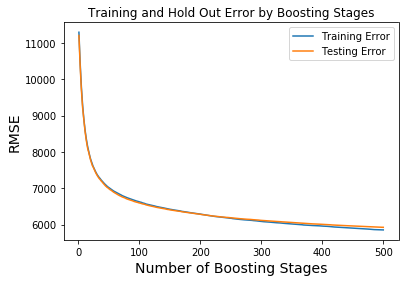

In [39]:
train_score = np.zeros(n_esti)
for i, y_pred in enumerate(gb.staged_predict(X_train)):
    train_score[i] = np.sqrt(mean_squared_error(y_train, y_pred))

test_score = np.zeros(n_esti)
for i, y_pred in enumerate(gb.staged_predict(X_test)):
    test_score[i] = np.sqrt(mean_squared_error(y_test, y_pred))
    
plt.plot(np.arange(n_esti) + 1, train_score,
        label="Training Error")
plt.plot(np.arange(n_esti) + 1, test_score,
        label="Testing Error")
plt.title("Training and Hold Out Error by Boosting Stages")
plt.xlabel('Number of Boosting Stages', fontsize=14)
plt.ylabel('RMSE', fontsize=14)
plt.legend(loc="upper right")

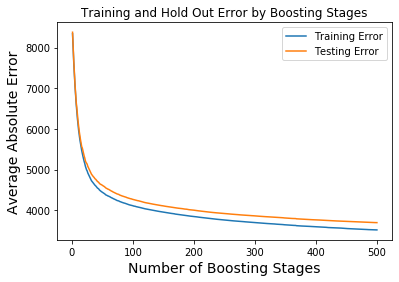

In [40]:
train_score = np.zeros(n_esti)
for i, y_pred in enumerate(gb.staged_predict(X_train)):
    train_score[i] = mean_absolute_error(y_train, y_pred)

test_score = np.zeros(n_esti)
for i, y_pred in enumerate(gb.staged_predict(X_test)):
    test_score[i] = mean_absolute_error(y_test, y_pred)
    
plt.plot(np.arange(n_esti) + 1, train_score,
        label="Training Error")
plt.plot(np.arange(n_esti) + 1, test_score,
        label="Testing Error")
plt.title("Training and Hold Out Error by Boosting Stages")
plt.xlabel('Number of Boosting Stages', fontsize=14)
plt.ylabel('Average Absolute Error', fontsize=14)
plt.legend(loc="upper right")

In [41]:
y_train_pred=gb.predict(X_train)
y_test_pred=gb.predict(X_test)

In [42]:
gb.loss_(y_train, y_train_pred)

34273346.82302062

In [43]:
gb.loss_(y_test, y_test_pred)

35116387.98604117

In [44]:
y_base=np.ones(len(y_test))*y.median()

mae_train=mean_absolute_error(y_train, y_train_pred)

mae_test = mean_absolute_error(y_test, y_test_pred)

mae_base = mean_absolute_error(y_test, y_base)

In [45]:
r2_score(y_train, y_train_pred)

0.753591922123956

In [46]:
r2_score(y_test, y_test_pred)

0.7408819635794182

In [47]:
print('MAE of training : {:2.2f}'.format(mae_train))
print('MAE of test : {:2.2f}'.format(mae_test))
print('MAE of base : {:2.2f}'.format(mae_base))
print('\nBase(Median of price) {}'.format(y.median()))

print('Improvement : {:2.2f}-fold'.format(mae_base/mae_test))


MAE of training : 3513.79
MAE of test : 3692.95
MAE of base : 8341.65

Base(Median of price) 10700.0
Improvement : 2.26-fold


# Civic

In [48]:
index_civic=X_test[X_test.civic==True].index
y_civic=y_test[index_civic]
X_civic=X_test[X_test.civic==True]
y_pred_civic=gb.predict(X_civic)

In [49]:
mae_civic_pred=mean_absolute_error(y_civic, y_pred_civic)

In [50]:
y_civic_median=np.ones(len(y_civic))*y_civic.median()

In [51]:
mae_civic_base=mean_absolute_error(y_civic, y_civic_median)

In [52]:
print('MAE of test : {:2.2f}'.format(mae_civic_pred))
print('MAE of base : {:2.2f}'.format(mae_civic_base))
print('\nBase(Median of price) {}'.format(y_civic.median()))
print('Improvement : {:2.2f}-fold'.format(mae_civic_base/mae_civic_pred))

MAE of test : 2111.25
MAE of base : 4906.54

Base(Median of price) 6999.5
Improvement : 2.32-fold


In [53]:
civic=pd.DataFrame({'actual': y_civic, 'pred':y_pred_civic})

In [54]:
civic[civic.pred<0]

,actual,pred
2298,1500,-479.171435
19836,1885,-1243.275619
98284,1995,-1253.772149
9810,2200,-336.233369


In [55]:
df=pre_clean_df()

In [56]:
df.iloc[civic[civic.pred<0].index]

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color
2298,SF bay area,1500,2003.0,honda,civic,fair,4 cylinders,hybrid,203000.0,clean,automatic,NaN,compact,sedan,blue
19836,inland empire,1885,2001.0,honda,civic,fair,4 cylinders,gas,NaN,salvage,automatic,fwd,compact,sedan,brown
98284,los angeles,1995,1998.0,honda,civic,fair,4 cylinders,gas,242000.0,clean,automatic,fwd,compact,hatchback,red
9810,imperial county,2200,2003.0,honda,civic,fair,4 cylinders,gas,193386.0,salvage,manual,fwd,compact,coupe,silver


In [57]:
#df.iloc[civic[civic.pred>=0].index]

# RandomForest

In [58]:
rf=RandomForestRegressor(max_depth=10, n_estimators=10)
rf.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=10,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=10,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

(323, 343)

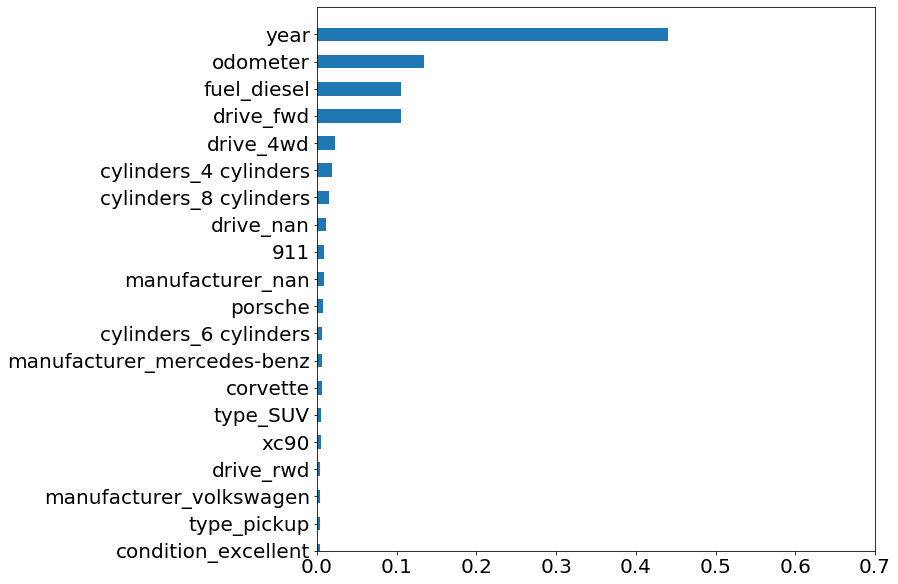

In [59]:
feat_scores = pd.DataFrame({'Fraction of Samples Affected' : rf.feature_importances_},
                           index=X.columns)
feat_scores = feat_scores.sort_values(by='Fraction of Samples Affected')
ax=feat_scores.plot(kind='barh', figsize=(10,10), fontsize=20, legend=False)
ax.set_xlim(0,.7)
ax.set_ylim(323,343)

In [60]:
px.scatter_3d(df, x='year', y='odometer', z='price', hover_name='price', color='city',template='plotly_dark', opacity=.5)

In [61]:
tested_data=pd.DataFrame({'actual': y_test, 'pred':y_test_pred})

In [62]:
df.iloc[tested_data[tested_data.pred<0].index]

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color
8613,orange county,2000,1999.0,toyota,corolla,fair,4 cylinders,gas,208000.0,clean,automatic,rwd,compact,NaN,brown
57858,sacramento,1000,2001.0,toyota,camry,fair,4 cylinders,gas,185369.0,salvage,automatic,fwd,mid-size,sedan,silver
18545,inland empire,2200,1993.0,chrysler,lebaron landau,fair,6 cylinders,gas,122221.0,clean,automatic,fwd,mid-size,sedan,white
10938,ventura county,1500,1998.0,buick,century,fair,6 cylinders,gas,169085.0,clean,automatic,fwd,mid-size,sedan,white
96764,fresno / madera,600,2001.0,kia,sephia,NaN,NaN,gas,135000.0,salvage,automatic,NaN,NaN,NaN,NaN
82255,sacramento,900,2003.0,chevrolet,cavalier,fair,4 cylinders,gas,249656.0,clean,automatic,fwd,compact,coupe,white
19356,inland empire,4900,2014.0,nissan,versa,salvage,4 cylinders,gas,69000.0,salvage,automatic,NaN,compact,sedan,silver
59748,visalia-tulare,1500,2001.0,dodge,neon,fair,4 cylinders,gas,149000.0,clean,automatic,fwd,compact,sedan,NaN
46810,visalia-tulare,2500,1996.0,toyota,camry,good,4 cylinders,gas,215000.0,salvage,automatic,NaN,full-size,sedan,white
77568,bakersfield,1600,1997.0,NaN,Geo Metro,good,3 cylinders,gas,144900.0,salvage,manual,fwd,compact,hatchback,white
